## Multivariate Analysis

## Life Expectancy (WHO)
Statistical Analysis on factors influencing Life Expectancy

### Context
Although there have been lot of studies undertaken in the past on factors affecting life expectancy considering demographic variables, income composition and mortality rates. It was found that affect of immunization and human development index was not taken into account in the past. Also, some of the past research was done considering multiple linear regression based on data set of one year for all the countries. Hence, this gives motivation to resolve both the factors stated previously by formulating a regression model based on mixed effects model and multiple linear regression while considering data from a period of 2000 to 2015 for all the countries. Important immunization like Hepatitis B, Polio and Diphtheria will also be considered. In a nutshell, this study will focus on immunization factors, mortality factors, economic factors, social factors and other health related factors as well. Since the observations this dataset are based on different countries, it will be easier for a country to determine the predicting factor which is contributing to lower value of life expectancy. This will help in suggesting a country which area should be given importance in order to efficiently improve the life expectancy of its population.

### Content
The project relies on accuracy of data. The Global Health Observatory (GHO) data repository under World Health Organization (WHO) keeps track of the health status as well as many other related factors for all countries The data-sets are made available to public for the purpose of health data analysis. The data-set related to life expectancy, health factors for 193 countries has been collected from the same WHO data repository website and its corresponding economic data was collected from United Nation website. Among all categories of health-related factors only those critical factors were chosen which are more representative. It has been observed that in the past 15 years , there has been a huge development in health sector resulting in improvement of human mortality rates especially in the developing nations in comparison to the past 30 years. Therefore, in this project we have considered data from year 2000-2015 for 193 countries for further analysis. The individual data files have been merged together into a single data-set. On initial visual inspection of the data showed some missing values. As the data-sets were from WHO, we found no evident errors. Missing data was handled in R software by using Missmap command. The result indicated that most of the missing data was for population, Hepatitis B and GDP. The missing data were from less known countries like Vanuatu, Tonga, Togo, Cabo Verde etc. Finding all data for these countries was difficult and hence, it was decided that we exclude these countries from the final model data-set. The final merged file(final dataset) consists of 22 Columns and 2938 row0’ 0s which meant 20 predicting variables. All predicting variables was then divided into several broad categories:Immunization related factors, Mortality factors, Economical factors and Social factors.

Refer notebook - https://www.kaggle.com/code/philbowman212/life-expectancy-exploratory-data-analysis/notebook
                
Refer notebook - https://www.kaggle.com/code/mayankbali2027202/life-expectancy-who-detailed-eda-and-exploration

Winsorize Data - https://www.statology.org/winsorize-data-excel/

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
from scipy.stats.mstats import winsorize
from dataprep.eda import create_report
# from sklearn.decomposition import PCA
# from sklearn.preprocessing import scale
# import factor_analyzer
# import os
%matplotlib inline

In [2]:
Life_Expectancy = pd.read_csv("GHO.csv")

In [3]:
data = Life_Expectancy.copy()

In [4]:
df = data.copy()

In [5]:
df.columns

Index(['Country', 'Year', 'Status', 'Life expectancy ', 'Adult Mortality',
       'infant deaths', 'Alcohol', 'percentage expenditure', 'Hepatitis B',
       'Measles ', ' BMI ', 'under-five deaths ', 'Polio', 'Total expenditure',
       'Diphtheria ', ' HIV/AIDS', 'GDP', 'Population',
       ' thinness  1-19 years', ' thinness 5-9 years',
       'Income composition of resources', 'Schooling'],
      dtype='object')

In [6]:
df.rename(columns = {"Life expectancy ": "Life_Expectancy",
                     "Adult Mortality":"Adult_Mortality",
                     "infant deaths":"Infant_Deaths",
                     "percentage expenditure":"Percentage_Expenditure",
                     "Hepatitis B":"HepatitisB",
                     " BMI " :"BMI",
                     "Measles ":"Measles",
                     "under-five deaths ": "Under_Five_Deaths",
                     "Total expenditure":"Total_Expenditure",
                     "Diphtheria ": "Diphtheria",
                     " thinness  1-19 years":"Thinness_10-19_Years",
                     " thinness 5-9 years":"Thinness_5-9_Years",
                     " HIV/AIDS":"HIV/AIDS",
                     "Income composition of resources":"Income_Composition_Of_Resources"}, inplace = True)

In [7]:
df.columns

Index(['Country', 'Year', 'Status', 'Life_Expectancy', 'Adult_Mortality',
       'Infant_Deaths', 'Alcohol', 'Percentage_Expenditure', 'HepatitisB',
       'Measles', 'BMI', 'Under_Five_Deaths', 'Polio', 'Total_Expenditure',
       'Diphtheria', 'HIV/AIDS', 'GDP', 'Population', 'Thinness_10-19_Years',
       'Thinness_5-9_Years', 'Income_Composition_Of_Resources', 'Schooling'],
      dtype='object')

In [8]:
df.head(10)

,Country,Year,Status,Life_Expectancy,Adult_Mortality,Infant_Deaths,Alcohol,Percentage_Expenditure,HepatitisB,Measles,...,Polio,Total_Expenditure,Diphtheria,HIV/AIDS,GDP,Population,Thinness_10-19_Years,Thinness_5-9_Years,Income_Composition_Of_Resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
5,Afghanistan,2010,Developing,58.8,279.0,74,0.01,79.679367,66.0,1989,...,66.0,9.20,66.0,0.1,553.328940,2883167.0,18.4,18.4,0.448,9.2
6,Afghanistan,2009,Developing,58.6,281.0,77,0.01,56.762217,63.0,2861,...,63.0,9.42,63.0,0.1,445.893298,284331.0,18.6,18.7,0.434,8.9
7,Afghanistan,2008,Developing,58.1,287.0,80,0.03,25.873925,64.0,1599,...,64.0,8.33,64.0,0.1,373.361116,2729431.0,18.8,18.9,0.433,8.7
8,Afghanistan,2007,Developing,57.5,295.0,82,0.02,10.910156,63.0,1141,...,63.0,6.73,63.0,0.1,369.835796,26616792.0,19.0,19.1,0.415,8.4
9,Afghanistan,2006,Developing,57.3,295.0,84,0.03,17.171518,64.0,1990,...,58.0,7.43,58.0,0.1,272.563770,2589345.0,19.2,19.3,0.405,8.1


In [9]:
df.tail(10)

,Country,Year,Status,Life_Expectancy,Adult_Mortality,Infant_Deaths,Alcohol,Percentage_Expenditure,HepatitisB,Measles,...,Polio,Total_Expenditure,Diphtheria,HIV/AIDS,GDP,Population,Thinness_10-19_Years,Thinness_5-9_Years,Income_Composition_Of_Resources,Schooling
2928,Zimbabwe,2009,Developing,50.0,587.0,30,4.64,1.040021,73.0,853,...,69.0,6.26,73.0,18.1,65.824121,1381599.0,7.5,7.4,0.419,9.9
2929,Zimbabwe,2008,Developing,48.2,632.0,30,3.56,20.843429,75.0,0,...,75.0,4.96,75.0,20.5,325.678573,13558469.0,7.8,7.8,0.421,9.7
2930,Zimbabwe,2007,Developing,46.6,67.0,29,3.88,29.814566,72.0,242,...,73.0,4.47,73.0,23.7,396.998217,1332999.0,8.2,8.2,0.414,9.6
2931,Zimbabwe,2006,Developing,45.4,7.0,28,4.57,34.262169,68.0,212,...,71.0,5.12,7.0,26.8,414.796232,13124267.0,8.6,8.6,0.408,9.5
2932,Zimbabwe,2005,Developing,44.6,717.0,28,4.14,8.717409,65.0,420,...,69.0,6.44,68.0,30.3,444.765750,129432.0,9.0,9.0,0.406,9.3
2933,Zimbabwe,2004,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8
2937,Zimbabwe,2000,Developing,46.0,665.0,24,1.68,0.000000,79.0,1483,...,78.0,7.10,78.0,43.5,547.358878,12222251.0,11.0,11.2,0.434,9.8


In [10]:
df.duplicated().sum()

0

In [11]:
df.nunique()

Country                             193
Year                                 16
Status                                2
Life_Expectancy                     362
Adult_Mortality                     425
Infant_Deaths                       209
Alcohol                            1076
Percentage_Expenditure             2328
HepatitisB                           87
Measles                             958
BMI                                 608
Under_Five_Deaths                   252
Polio                                73
Total_Expenditure                   818
Diphtheria                           81
HIV/AIDS                            200
GDP                                2490
Population                         2278
Thinness_10-19_Years                200
Thinness_5-9_Years                  207
Income_Composition_Of_Resources     625
Schooling                           173
dtype: int64

In [12]:
df.describe(include = "all").transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Country,2938,193,Afghanistan,16,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Year,2938.0,NaN,NaN,NaN,2007.51872,4.613841,2000.0,2004.0,2008.0,2012.0,2015.0
Status,2938,2,Developing,2426,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Life_Expectancy,2928.0,NaN,NaN,NaN,69.224932,9.523867,36.3,63.1,72.1,75.7,89.0
Adult_Mortality,2928.0,NaN,NaN,NaN,164.796448,124.292079,1.0,74.0,144.0,228.0,723.0
Infant_Deaths,2938.0,NaN,NaN,NaN,30.303948,117.926501,0.0,0.0,3.0,22.0,1800.0
Alcohol,2744.0,NaN,NaN,NaN,4.602861,4.052413,0.01,0.8775,3.755,7.7025,17.87
Percentage_Expenditure,2938.0,NaN,NaN,NaN,738.251295,1987.914858,0.0,4.685343,64.912906,441.534144,19479.91161
HepatitisB,2385.0,NaN,NaN,NaN,80.940461,25.070016,1.0,77.0,92.0,97.0,99.0
Measles,2938.0,NaN,NaN,NaN,2419.59224,11467.272489,0.0,0.0,17.0,360.25,212183.0


In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2938 entries, 0 to 2937
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Country                          2938 non-null   object 
 1   Year                             2938 non-null   int64  
 2   Status                           2938 non-null   object 
 3   Life_Expectancy                  2928 non-null   float64
 4   Adult_Mortality                  2928 non-null   float64
 5   Infant_Deaths                    2938 non-null   int64  
 6   Alcohol                          2744 non-null   float64
 7   Percentage_Expenditure           2938 non-null   float64
 8   HepatitisB                       2385 non-null   float64
 9   Measles                          2938 non-null   int64  
 10  BMI                              2904 non-null   float64
 11  Under_Five_Deaths                2938 non-null   int64  
 12  Polio               

In [14]:
df['Country'] = df['Country'].astype('string')
df['Status'] = df['Status'].astype('string')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2938 entries, 0 to 2937
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Country                          2938 non-null   string 
 1   Year                             2938 non-null   int64  
 2   Status                           2938 non-null   string 
 3   Life_Expectancy                  2928 non-null   float64
 4   Adult_Mortality                  2928 non-null   float64
 5   Infant_Deaths                    2938 non-null   int64  
 6   Alcohol                          2744 non-null   float64
 7   Percentage_Expenditure           2938 non-null   float64
 8   HepatitisB                       2385 non-null   float64
 9   Measles                          2938 non-null   int64  
 10  BMI                              2904 non-null   float64
 11  Under_Five_Deaths                2938 non-null   int64  
 12  Polio               

  0%|                                                                                         | 0/4503 [00:00<…

D:\ProgramData\Anaconda3\envs\Jai\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))


DataPrep Report
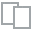
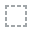
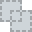
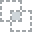
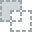
...
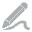
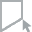
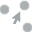
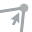
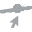

In [15]:
create_report(df)

In [16]:
def checkna(data):
    missing_values= data.isna().sum().reset_index()
    missing_values.columns= ["Features", "Missing_Values"]
    missing_values["Missing_Percent"]= round(missing_values.Missing_Values/len(data)*100,2)
    return missing_values[missing_values.Missing_Values > 0 ]

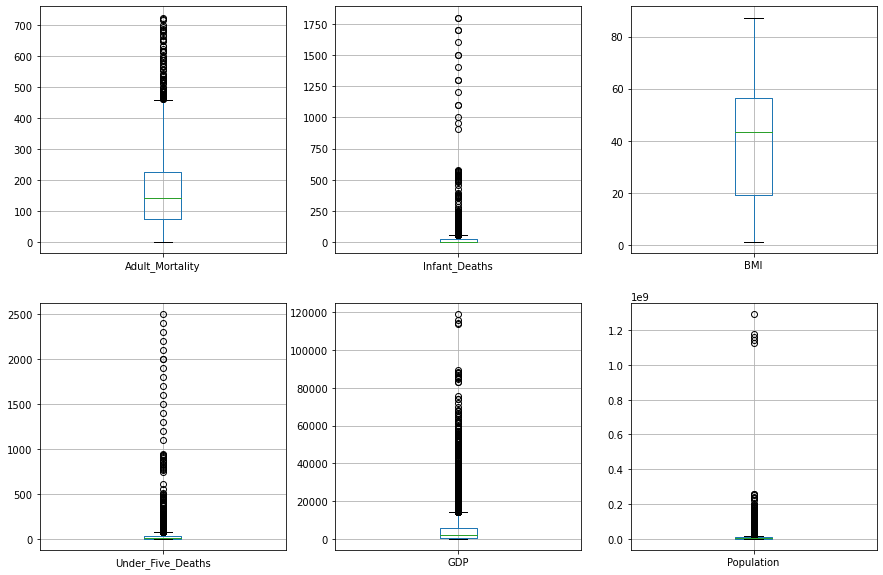

In [17]:
plt.figure(figsize=(15,10))
for i, col in enumerate(['Adult_Mortality', 'Infant_Deaths', 'BMI', 'Under_Five_Deaths', 'GDP', 'Population'], start=1):
    plt.subplot(2, 3, i)
    df.boxplot(col)

There are a few of the above that could simply be outliers, but there are some that almost certainly have to be errors of some sort. 

Of the above variables, changes to null will be made for the following since these numbers don't make any sense:

Adult mortality rates lower than the 5th percentile

Infant deaths of 0

BMI less than 10 and greater than 50

Under Five deaths of 0


In [18]:
checkna(df)

,Features,Missing_Values,Missing_Percent
3,Life_Expectancy,10,0.34
4,Adult_Mortality,10,0.34
6,Alcohol,194,6.60
8,HepatitisB,553,18.82
10,BMI,34,1.16
12,Polio,19,0.65
13,Total_Expenditure,226,7.69
14,Diphtheria,19,0.65
16,GDP,448,15.25
17,Population,652,22.19


In [19]:
mort_5_percentile = np.percentile(df.Adult_Mortality.dropna(), 5)
df.Adult_Mortality = df.apply(lambda x: np.nan if x.Adult_Mortality < mort_5_percentile else x.Adult_Mortality, axis=1)
df.Infant_Deaths = df.Infant_Deaths.replace(0, np.nan)
df.BMI = df.apply(lambda x: np.nan if (x.BMI < 10 or x.BMI > 50) else x.BMI, axis=1)
df['Under_Five_Deaths'] = df['Under_Five_Deaths'].replace(0, np.nan)

In [20]:
checkna(df)

,Features,Missing_Values,Missing_Percent
3,Life_Expectancy,10,0.34
4,Adult_Mortality,155,5.28
5,Infant_Deaths,848,28.86
6,Alcohol,194,6.60
8,HepatitisB,553,18.82
10,BMI,1456,49.56
11,Under_Five_Deaths,785,26.72
12,Polio,19,0.65
13,Total_Expenditure,226,7.69
14,Diphtheria,19,0.65


In [21]:
# sns.heatmap(pd.isnull(df))
# dataset.isnull().sum()

In [22]:
df.isnull().sum()

Country                               0
Year                                  0
Status                                0
Life_Expectancy                      10
Adult_Mortality                     155
Infant_Deaths                       848
Alcohol                             194
Percentage_Expenditure                0
HepatitisB                          553
Measles                               0
BMI                                1456
Under_Five_Deaths                   785
Polio                                19
Total_Expenditure                   226
Diphtheria                           19
HIV/AIDS                              0
GDP                                 448
Population                          652
Thinness_10-19_Years                 34
Thinness_5-9_Years                   34
Income_Composition_Of_Resources     167
Schooling                           163
dtype: int64

In [23]:
checkna(df)

,Features,Missing_Values,Missing_Percent
3,Life_Expectancy,10,0.34
4,Adult_Mortality,155,5.28
5,Infant_Deaths,848,28.86
6,Alcohol,194,6.60
8,HepatitisB,553,18.82
10,BMI,1456,49.56
11,Under_Five_Deaths,785,26.72
12,Polio,19,0.65
13,Total_Expenditure,226,7.69
14,Diphtheria,19,0.65


In [24]:
# Dealing with Missing Values (replacing with mean value for the year)
null_col = ( 'Life_Expectancy', 'Adult_Mortality','Infant_Deaths','Under_Five_Deaths',	
        'Alcohol', 'HepatitisB',
       'BMI', 'Polio', 'Total_Expenditure',
       'Diphtheria','GDP', 'Population', 'Thinness_10-19_Years',
       'Thinness_5-9_Years', 'Income_Composition_Of_Resources', 'Schooling')
data_valid = []
for year in list(df.Year.unique()):
    year_data = df[df.Year == year].copy()
    for col in null_col:
        year_data[col] = year_data[col].fillna(year_data[col].dropna().mean()).copy()
    data_valid.append(year_data)
df = pd.concat(data_valid).copy()
df.isnull().sum(axis = 0)

Country                            0
Year                               0
Status                             0
Life_Expectancy                    0
Adult_Mortality                    0
Infant_Deaths                      0
Alcohol                            0
Percentage_Expenditure             0
HepatitisB                         0
Measles                            0
BMI                                0
Under_Five_Deaths                  0
Polio                              0
Total_Expenditure                  0
Diphtheria                         0
HIV/AIDS                           0
GDP                                0
Population                         0
Thinness_10-19_Years               0
Thinness_5-9_Years                 0
Income_Composition_Of_Resources    0
Schooling                          0
dtype: int64

In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2938 entries, 0 to 2937
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Country                          2938 non-null   string 
 1   Year                             2938 non-null   int64  
 2   Status                           2938 non-null   string 
 3   Life_Expectancy                  2938 non-null   float64
 4   Adult_Mortality                  2938 non-null   float64
 5   Infant_Deaths                    2938 non-null   float64
 6   Alcohol                          2938 non-null   float64
 7   Percentage_Expenditure           2938 non-null   float64
 8   HepatitisB                       2938 non-null   float64
 9   Measles                          2938 non-null   int64  
 10  BMI                              2938 non-null   float64
 11  Under_Five_Deaths                2938 non-null   float64
 12  Polio               

In [26]:
checkna(df)

,Features,Missing_Values,Missing_Percent


In [27]:
df.describe()

,Year,Life_Expectancy,Adult_Mortality,Infant_Deaths,Alcohol,Percentage_Expenditure,HepatitisB,Measles,BMI,Under_Five_Deaths,Polio,Total_Expenditure,Diphtheria,HIV/AIDS,GDP,Population,Thinness_10-19_Years,Thinness_5-9_Years,Income_Composition_Of_Resources,Schooling
count,2938.000000,2938.000000,2938.000000,2938.000000,2938.000000,2938.000000,2938.000000,2938.000000,2938.000000,2938.000000,2938.000000,2938.000000,2938.000000,2938.000000,2938.000000,2.938000e+03,2938.000000,2938.000000,2938.000000,2938.000000
mean,2007.518720,69.231777,172.924761,42.458242,4.644013,738.251295,80.322757,2419.592240,29.080821,57.191600,82.536808,6.007815,82.305166,1.742103,7481.955600,1.275499e+07,4.839464,4.870027,0.627686,11.993407
std,4.613841,9.508362,118.847313,116.366814,3.919849,1987.914858,22.682329,11467.272489,8.510613,158.481956,23.353973,2.416215,23.642961,5.077785,13159.210856,5.384718e+07,4.394616,4.482803,0.205212,3.268724
min,2000.000000,36.300000,13.000000,1.000000,0.010000,0.000000,1.000000,0.000000,11.200000,1.000000,3.000000,0.370000,2.000000,0.100000,1.681350,3.400000e+01,0.100000,0.100000,0.000000,0.000000
25%,2004.000000,63.200000,84.000000,4.000000,1.092500,4.685343,74.099237,0.000000,25.600000,4.000000,78.000000,4.370000,78.000000,0.100000,580.486996,4.189172e+05,1.600000,1.600000,0.504250,10.300000
50%,2008.000000,72.000000,157.000000,28.000000,4.140000,64.912906,87.000000,17.000000,29.153086,34.000000,93.000000,5.910000,93.000000,0.100000,3116.561755,3.675929e+06,3.400000,3.400000,0.673000,12.300000
75%,2012.000000,75.600000,227.000000,43.766917,7.390000,441.534144,96.000000,360.250000,29.444048,60.014815,97.000000,7.330000,97.000000,0.800000,7464.487887,1.181332e+07,7.100000,7.200000,0.772000,14.100000
max,2015.000000,89.000000,723.000000,1800.000000,17.870000,19479.911610,99.000000,212183.000000,49.900000,2500.000000,99.000000,17.600000,99.000000,50.600000,119172.741800,1.293859e+09,27.700000,28.600000,0.948000,20.700000


### Outliers

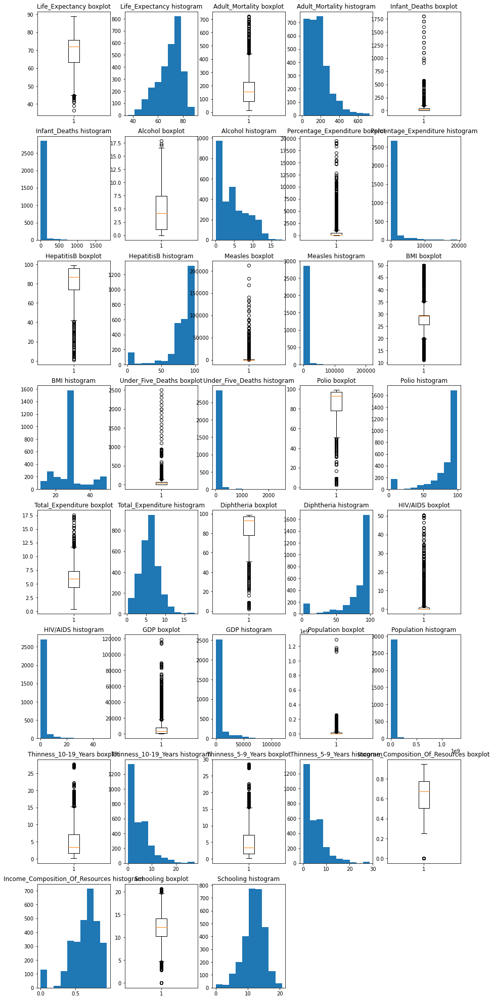

In [28]:
cont_vars = list(df.columns)[3:]
def outliers_visual(data):
    plt.figure(figsize=(15, 40))
    i = 0
    for col in cont_vars:
        i += 1
        plt.subplot(9, 5, i)
        plt.boxplot(data[col])
        plt.title('{} boxplot'.format(col))
        i += 1
        plt.subplot(9, 5, i)
        plt.hist(data[col])
        plt.title('{} histogram'.format(col))
    plt.show()
outliers_visual(df)

In [29]:
def outlier_count(col, data=df):
    print(15*'-' + col + 15*'-')
    q75, q25 = np.percentile(data[col], [75, 25])
    iqr = q75 - q25
    min_val = q25 - (iqr*1.5)
    max_val = q75 + (iqr*1.5)
    outlier_count = len(np.where((data[col] > max_val) | (data[col] < min_val))[0])
    outlier_percent = round(outlier_count/len(data[col])*100, 2)
    print('Number of outliers: {}'.format(outlier_count))
    print('Percent of data that is outlier: {}%'.format(outlier_percent))

In [30]:
for col in cont_vars:
    outlier_count(col)

---------------Life_Expectancy---------------
Number of outliers: 17
Percent of data that is outlier: 0.58%
---------------Adult_Mortality---------------
Number of outliers: 97
Percent of data that is outlier: 3.3%
---------------Infant_Deaths---------------
Number of outliers: 135
Percent of data that is outlier: 4.59%
---------------Alcohol---------------
Number of outliers: 3
Percent of data that is outlier: 0.1%
---------------Percentage_Expenditure---------------
Number of outliers: 389
Percent of data that is outlier: 13.24%
---------------HepatitisB---------------
Number of outliers: 222
Percent of data that is outlier: 7.56%
---------------Measles---------------
Number of outliers: 542
Percent of data that is outlier: 18.45%
---------------BMI---------------
Number of outliers: 973
Percent of data that is outlier: 33.12%
---------------Under_Five_Deaths---------------
Number of outliers: 142
Percent of data that is outlier: 4.83%
---------------Polio---------------
Number of ou

In [31]:
def test_wins(col, lower_limit=0, upper_limit=0, show_plot=True):
    wins_data = winsorize(df[col], limits=(lower_limit, upper_limit))
    wins_dict[col] = wins_data
    if show_plot == True:
        plt.figure(figsize=(15,5))
        plt.subplot(121)
        plt.boxplot(df[col])
        plt.title('original {}'.format(col))
        plt.subplot(122)
        plt.boxplot(wins_data)
        plt.title('wins=({},{}) {}'.format(lower_limit, upper_limit, col))
        plt.show()

In [32]:
cont_vars[7]

'BMI'

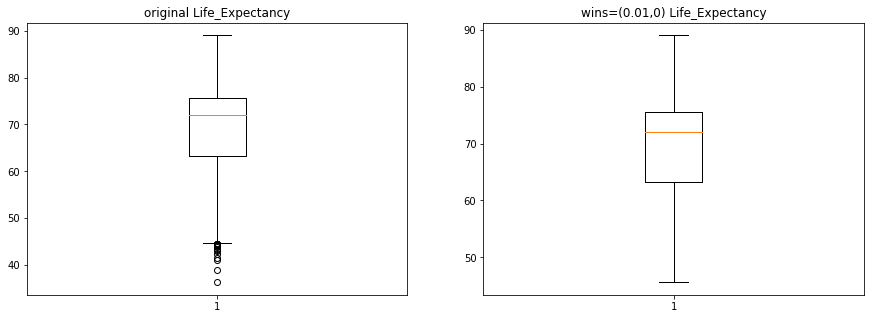

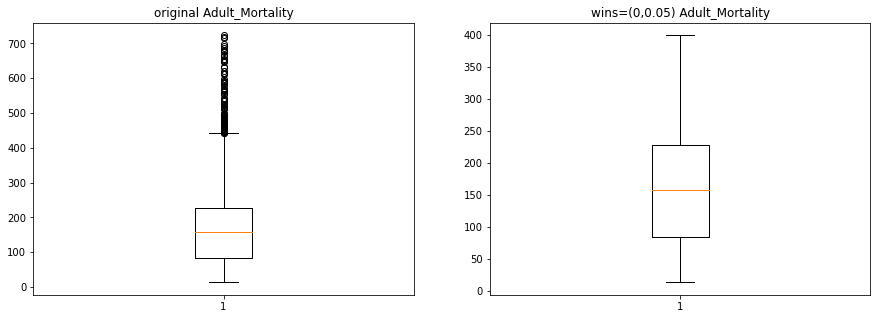

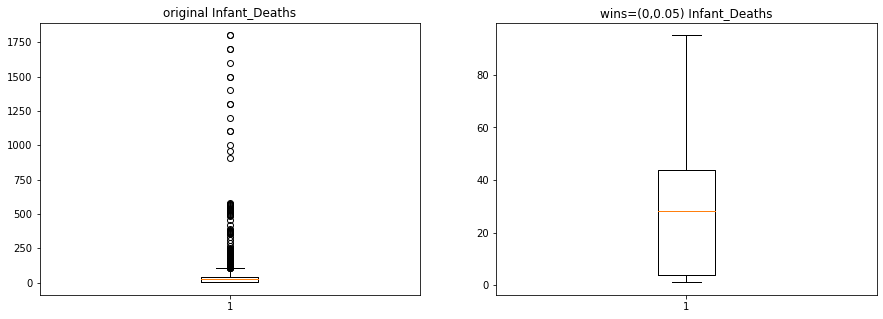

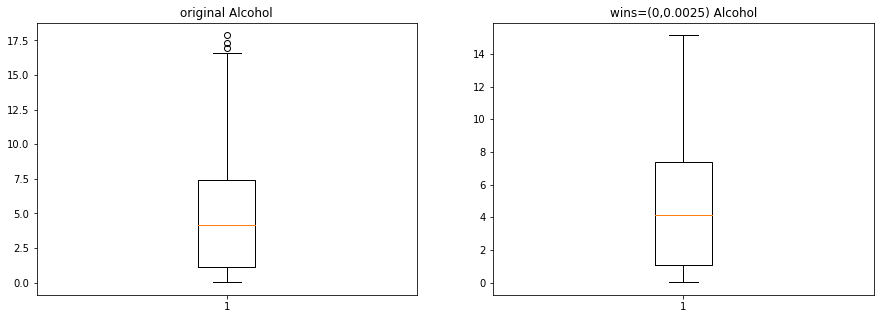

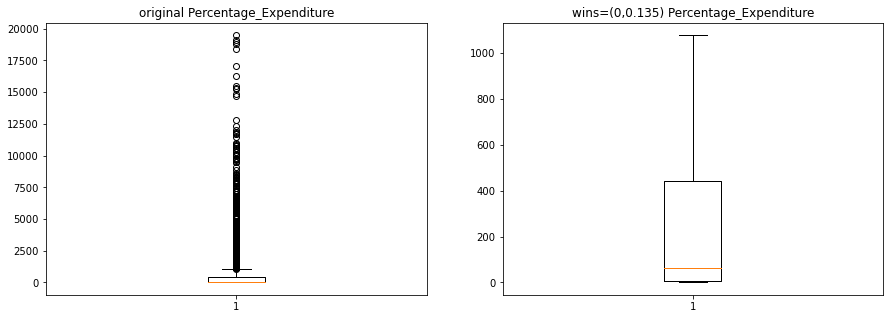

...

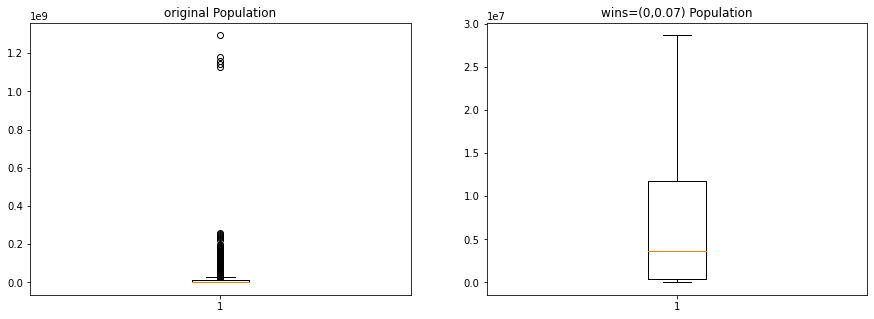

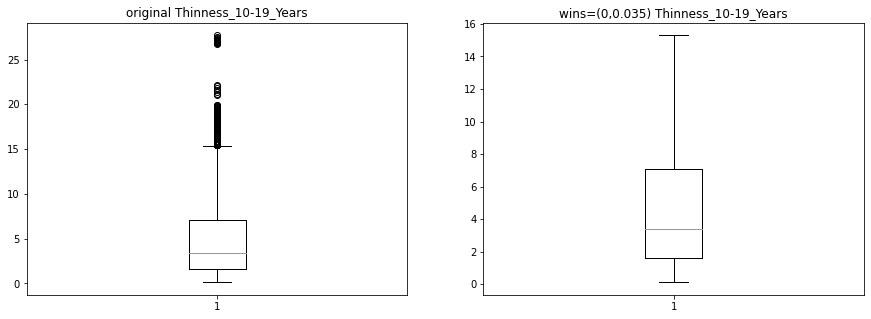

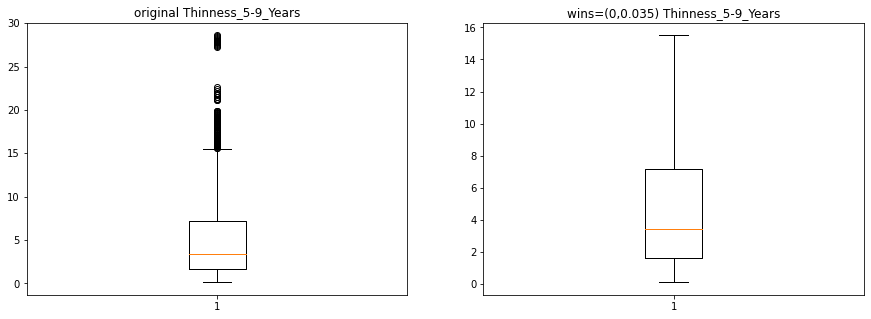

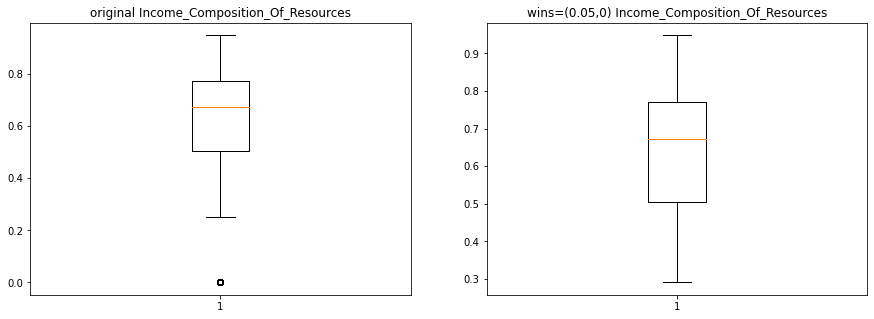

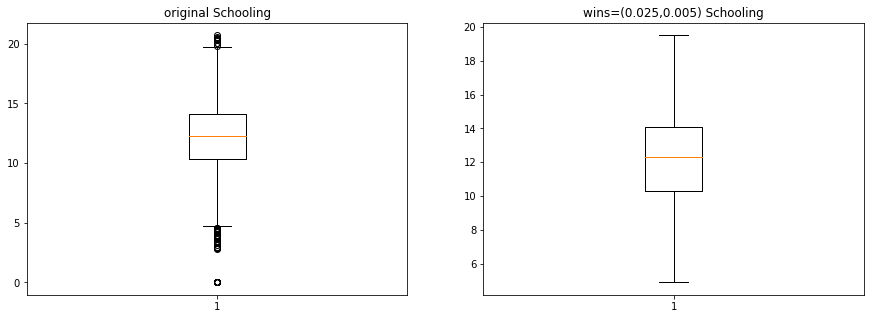

In [33]:
wins_dict = {}
test_wins(cont_vars[0], lower_limit=.01, show_plot=True)
test_wins(cont_vars[1], upper_limit=.05, show_plot=True)
test_wins(cont_vars[2], upper_limit=.05, show_plot=True)
test_wins(cont_vars[3], upper_limit=.0025, show_plot=True)
test_wins(cont_vars[4], upper_limit=.135, show_plot=True)
test_wins(cont_vars[5], lower_limit=.1, show_plot=True)
test_wins(cont_vars[6], upper_limit=.19, show_plot=True)
test_wins(cont_vars[7], lower_limit=.17,upper_limit=.17, show_plot=True)
test_wins(cont_vars[8], upper_limit=.05, show_plot=True)
test_wins(cont_vars[9], lower_limit=.1, show_plot=True)
test_wins(cont_vars[10], upper_limit=.02, show_plot=True)
test_wins(cont_vars[11], lower_limit=.105, show_plot=True)
test_wins(cont_vars[12], upper_limit=.185, show_plot=True)
test_wins(cont_vars[13], upper_limit=.105, show_plot=True)
test_wins(cont_vars[14], upper_limit=.07, show_plot=True)
test_wins(cont_vars[15], upper_limit=.035, show_plot=True)
test_wins(cont_vars[16], upper_limit=.035, show_plot=True)
test_wins(cont_vars[17], lower_limit=.05, show_plot=True)
test_wins(cont_vars[18], lower_limit=.025, upper_limit=.005, show_plot=True)

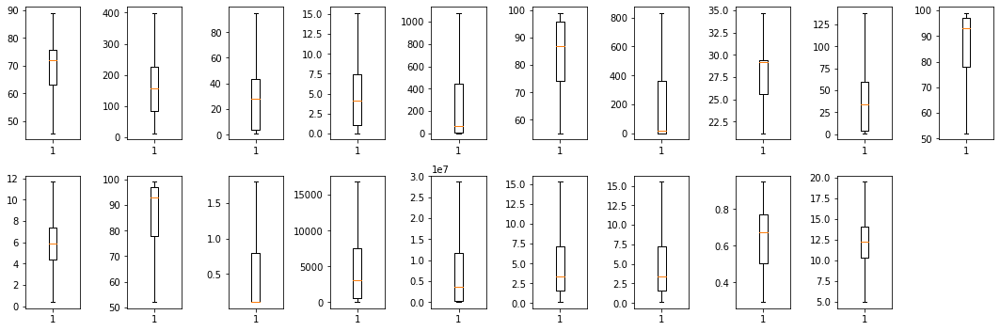

In [34]:
plt.figure(figsize=(15,5))
for i, col in enumerate(cont_vars, 1):
    plt.subplot(2, 10, i)
    plt.boxplot(wins_dict[col])
plt.tight_layout()
plt.show()


In [35]:
wins_df = df.iloc[:, 0:3]
for col in cont_vars:
    wins_df[col] = wins_dict[col]

In [36]:
wins_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2938 entries, 0 to 2937
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Country                          2938 non-null   string 
 1   Year                             2938 non-null   int64  
 2   Status                           2938 non-null   string 
 3   Life_Expectancy                  2938 non-null   float64
 4   Adult_Mortality                  2938 non-null   float64
 5   Infant_Deaths                    2938 non-null   float64
 6   Alcohol                          2938 non-null   float64
 7   Percentage_Expenditure           2938 non-null   float64
 8   HepatitisB                       2938 non-null   float64
 9   Measles                          2938 non-null   int64  
 10  BMI                              2938 non-null   float64
 11  Under_Five_Deaths                2938 non-null   float64
 12  Polio               

In [37]:
wins_df.isnull().sum()

Country                            0
Year                               0
Status                             0
Life_Expectancy                    0
Adult_Mortality                    0
Infant_Deaths                      0
Alcohol                            0
Percentage_Expenditure             0
HepatitisB                         0
Measles                            0
BMI                                0
Under_Five_Deaths                  0
Polio                              0
Total_Expenditure                  0
Diphtheria                         0
HIV/AIDS                           0
GDP                                0
Population                         0
Thinness_10-19_Years               0
Thinness_5-9_Years                 0
Income_Composition_Of_Resources    0
Schooling                          0
dtype: int64

In [38]:
checkna(wins_df)

,Features,Missing_Values,Missing_Percent


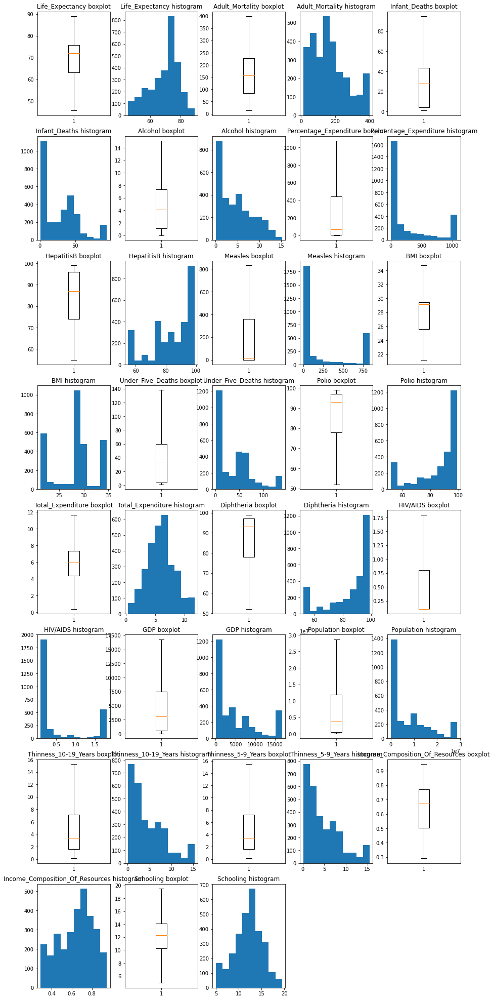

In [39]:
outliers_visual(wins_df)

In [40]:
def outlier_count(col, data=wins_df):
    print(15*'-' + col + 15*'-')
    q75, q25 = np.percentile(data[col], [75, 25])
    iqr = q75 - q25
    min_val = q25 - (iqr*1.5)
    max_val = q75 + (iqr*1.5)
    outlier_count = len(np.where((data[col] > max_val) | (data[col] < min_val))[0])
    outlier_percent = round(outlier_count/len(data[col])*100, 2)
    print('Number of outliers: {}'.format(outlier_count))
    print('Percent of data that is outlier: {}%'.format(outlier_percent))

In [41]:
variables = list(wins_df.columns)[3:]
for col in variables:
    outlier_count(col)

---------------Life_Expectancy---------------
Number of outliers: 0
Percent of data that is outlier: 0.0%
---------------Adult_Mortality---------------
Number of outliers: 0
Percent of data that is outlier: 0.0%
---------------Infant_Deaths---------------
Number of outliers: 0
Percent of data that is outlier: 0.0%
---------------Alcohol---------------
Number of outliers: 0
Percent of data that is outlier: 0.0%
---------------Percentage_Expenditure---------------
Number of outliers: 0
Percent of data that is outlier: 0.0%
---------------HepatitisB---------------
Number of outliers: 0
Percent of data that is outlier: 0.0%
---------------Measles---------------
Number of outliers: 0
Percent of data that is outlier: 0.0%
---------------BMI---------------
Number of outliers: 0
Percent of data that is outlier: 0.0%
---------------Under_Five_Deaths---------------
Number of outliers: 0
Percent of data that is outlier: 0.0%
---------------Polio---------------
Number of outliers: 0
Percent of dat

  0%|                                                                                         | 0/4503 [00:00<…

D:\ProgramData\Anaconda3\envs\Jai\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))


DataPrep Report
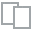
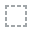
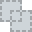
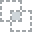
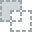
...
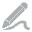
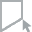
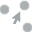
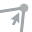
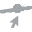

In [42]:
create_report(wins_df)